In [44]:
from src.utils import load_json
import pandas as pd
from rdkit import Chem
from rdkit.Chem import AllChem, Draw
from rdkit.Chem.Draw import IPythonConsole
IPythonConsole.drawOptions.addAtomIndices = True

In [ ]:
'''
TODO
-----
- Make sure n_min operators == n_rcs for every entry in known reactions
- Figure out whether each reaction center on a given side of the operator
template is unique
- Possible to use smiles/smarts strings to compare reaction centers?
'''

In [3]:
krs = load_json("../data/mapping/known_rxns_swissprot_enzymes_240310_v2.json")

In [7]:
bad_rxns = []
for k, v in krs.items():
    if len(v['rcs']) != len(v['min_rules']):
        bad_rxns.append(k)

print(len(bad_rxns))

0


In [16]:
min_rules = pd.read_csv("../data/rules/minimal1224_all_uniprot.tsv", sep='\t')
min_rules.head()

,Name,Reactants,SMARTS,Products,Comments
0,rule0001,Any;Any,[#6:1]-[#8:2].[#8:3]>>[#6:1]-[#8:3].[#8:2],Any;Any,A0A060PLD9;A0A0P0YNP7;A0A0P9RZM9;A1XCQ0;A3E242...
1,rule0002,Any;NAD_CoF,[#6:1]-[#8:2].[#6:3]1:[#6:4]:[#6:5]:[#6:6]:[#7...,NADH_CoF;Any,A0A023RBJ1;A0A060KZ16;A0A060TBM3;A0A072UJB3;A0...
2,rule0003,NADH_CoF;Any,[#6:1]1=[#6:2]-[#7:3]-[#6:4]=[#6:5]-[#6:6]-1.[...,Any;NAD_CoF,A0A023RBJ1;A0A060KZ16;A0A060TBM3;A0A072UJB3;A0...
3,rule0004,Any;NADH_CoF;O2,[#6:1].[#6:2]1=[#6:3]-[#7:4]-[#6:5]=[#6:6]-[#6...,Any;NAD_CoF;WATER,A0A1P8W705;A0A250DUW2;A1Z745;A5HMH6;A5HMH7;A5H...
4,rule0005,Any;NAD_CoF;WATER,[#6:1]-[#8:2].[#6:3]1:[#6:4]:[#6:5]:[#6:6]:[#7...,Any;NADH_CoF;O2,A0A1P8W705;A0A250DUW2;A1Z745;A5HMH6;A5HMH7;A5H...


In [18]:
import re
def get_patts_from_operator(smarts_str, side):
    '''
    Args
    -----
    smarts_str
    side:int - 0 | 1 for left or right
    '''

    # lhs smarts pattern
    lhs_smarts = smarts_str.split('>>')[0]
    lhs_smarts = re.sub(r':[0-9]+]', ']', lhs_smarts)

    # identify each fragment
    smarts_list = []
    temp_fragment = []

    # append complete fragments only
    for fragment in lhs_smarts.split('.'):
        temp_fragment += [fragment]
        if '.'.join(temp_fragment).count('(') == '.'.join(temp_fragment).count(')'):
            smarts_list.append('.'.join(temp_fragment))
            temp_fragment = []

            # remove component grouping for substructure matching
            if '.' in smarts_list[-1]:
                smarts_list[-1] = smarts_list[-1].replace('(', '', 1)[::-1].replace(')', '', 1)[::-1]

    return smarts_list

In [36]:
bad_rules = []
for i, row in min_rules.iterrows():
    for side in range(2):
        rcs = get_patts_from_operator(row['SMARTS'], side)
        unique_rcs = set(rcs)

        if len(rcs) != len(unique_rcs):
            bad_rules.append((row['Name'], side))
print(len(bad_rules))

164


In [30]:
i = 0
full_sma = min_rules.loc[min_rules['Name'] == bad_rules[i][0], 'SMARTS'].values[0]
full_sma.split('>>')[bad_rules[i][1]]

'[#6:1]-[#8:2].[#6:3]-[#8:4].[#6:5]=[#8:6]'

In [31]:
min_rules.loc[min_rules['Name'] == bad_rules[i][0], 'Products'].values[0]

'Any;Any;O2'

In [34]:
for i, row in min_rules.iterrows():
    for side in range(2):
        print(get_patts_from_operator(row['SMARTS'], side))

['[#6]-[#8]', '[#8]']
['[#6]-[#8]', '[#8]']
['[#6]-[#8]', '[#6]1:[#6]:[#6]:[#6]:[#7+]:[#6]:1']
['[#6]-[#8]', '[#6]1:[#6]:[#6]:[#6]:[#7+]:[#6]:1']
['[#6]1=[#6]-[#7]-[#6]=[#6]-[#6]-1', '[#6]=[#8]']
['[#6]1=[#6]-[#7]-[#6]=[#6]-[#6]-1', '[#6]=[#8]']
['[#6]', '[#6]1=[#6]-[#7]-[#6]=[#6]-[#6]-1', '[#8]=[#8]']
['[#6]', '[#6]1=[#6]-[#7]-[#6]=[#6]-[#6]-1', '[#8]=[#8]']
['[#6]-[#8]', '[#6]1:[#6]:[#6]:[#6]:[#7+]:[#6]:1', '[#8]']
['[#6]-[#8]', '[#6]1:[#6]:[#6]:[#6]:[#7+]:[#6]:1', '[#8]']
['[#6]-[#8]', '[#8]']
['[#6]-[#8]', '[#8]']
['[#6]-[#8]', '[#8]']
['[#6]-[#8]', '[#8]']
['[#6]-[#8]', '[#8]']
['[#6]-[#8]', '[#8]']
['[#6]-[#8]', '[#8]']
['[#6]-[#8]', '[#8]']
['[#16]', '[#6]-[#8]']
['[#16]', '[#6]-[#8]']
['[#6]-[#16+]', '[#8]']
['[#6]-[#16+]', '[#8]']
['[#6]-[#8]', '[#7]']
['[#6]-[#8]', '[#7]']
['[#6]-[#7]', '[#8]']
['[#6]-[#7]', '[#8]']
['[#8]', '[#8]-[#15]']
['[#8]', '[#8]-[#15]']
['[#8]', '[#8]-[#15]']
['[#8]', '[#8]-[#15]']
['[#8]', '[#8]-[#15]']
['[#8]', '[#8]-[#15]']
['[#8]', '[#8]-[#15]']
[

In [32]:
for i, (k, v) in enumerate(krs.items()):
    sma = v['smarts']
    lhs = sma.split('>>').split('.')
    mols = [Chem.MolFromSmiles(smi) for smi in lhs]

    for rc in v['rcs']:
        for j, elt in enumerate(rc):
            


{'R1b14b079add4f5306e5f50c276a3b0ffae6b7856d3703740c5478c69713b4458': {'smarts': 'NC(=O)c1ccc[n+](C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(O)C3O)C(O)C2O)c1>>NC(=O)c1cccnc1.Nc1ncnc2c1ncn2C1OC2COP(=O)(O)OP(=O)(O)OCC3OC(OC1C2O)C(O)C3O',
  'imt_rules': [],
  'min_rules': [],
  'enzymes': [['I1GTC2',
    'MASSGLSSRRSIMASRLTASAEAVNEPRRGAVVSRRVEYDEESLAGAGGESRYEVFINHRGVDTKRTVARLLYDRLAQAGLRGFLDNMSMRPGDRLEERIGSAIRECTVAVAIFSPSYCDSEYCLRELAMLVESRKAIIPIFYDIKPSDLLLPQAVADSEVYLPRDLERFKFALREAKHTVGITYDSATGDMAELVSAAADAVMYNMEKMETVQRRETMILSRL',
    ['3.2.2.6'],
    1.0,
    'Evidence at protein level',
    'reviewed',
    'Brachypodium distachyon (Purple false brome) (Trachynia distachya)'],
   ['A0A290U7C4',
    'MLTSSSHHGRSYDVFLSFRGEDTRKTFVGHLFNALIEKGIHTFMDDKELKRGKSISSELMKAIGESRFAVVVFSKNYASSTWCLEELVKILEIHEKFELIVVPVFYDVDPSTVRKQNGEYAVCFTKFEANLVDDRDKVLRWREALTKVANISGHDLRNTYNGDESKCIQQILKDIFDKFCFSISITNRDLVGIESQIKKLSSLLRMDLKGVRLVGIWGMGGVGKTTAARALFNRYYQNFESACFLEDVKEYLQHHTLLYLQKTLLSKLLKVEFVDCTDTEEMCVILKRR

In [38]:
smi = 'OCC'
patt = Chem.MolFromSmarts('[#8].[#6]-[#6]')
mol = Chem.MolFromSmiles(smi)
mol.GetSubstructMatches(patt)

((0, 1, 2),)

In [55]:
# Visualize failed PR-KR matches

kr_sma = 'C=CC(C)(SCC(NC(=O)CCC(N)C(=O)O)C(=O)NCC(=O)O)C(=O)O.NC(=O)C1=CN(C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(O)C3O)C(O)C2O)C=CC1.NC(=O)C1=CN(C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(O)C3O)C(O)C2O)C=CC1>>C=CC(C)(CO)SCC(NC(=O)CCC(N)C(=O)O)C(=O)NCC(=O)O.NC(=O)c1ccc[n+](C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(O)C3O)C(O)C2O)c1.NC(=O)c1ccc[n+](C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(O)C3O)C(O)C2O)c1.O'
pr_sma = 'O=C(O)CCC(=O)C(=O)O.NC(=O)C1=CN(C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(OP(=O)(O)O)C3O)C(O)C2O)C=CC1>>O=C(O)C(=O)CCC(O)O.NC(=O)c1ccc[n+](C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(OP(=O)(O)O)C3O)C(O)C2O)c1'
kr_rcts = [Chem.MolFromSmiles(elt) for elt in kr_sma.split('>>')[0].split('.')]
pr_rcts = [Chem.MolFromSmiles(elt) for elt in pr_sma.split('>>')[0].split('.')]
pr_pdts = [Chem.MolFromSmiles(elt) for elt in pr_sma.split('>>')[1].split('.')]

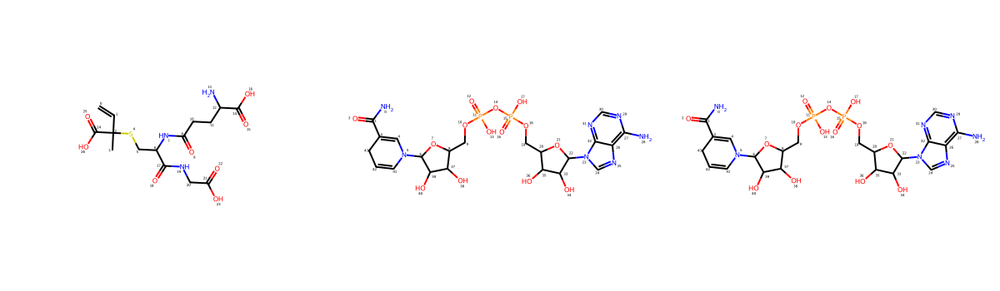

In [56]:
Draw.MolsToGridImage(kr_rcts, subImgSize=(400, 350))

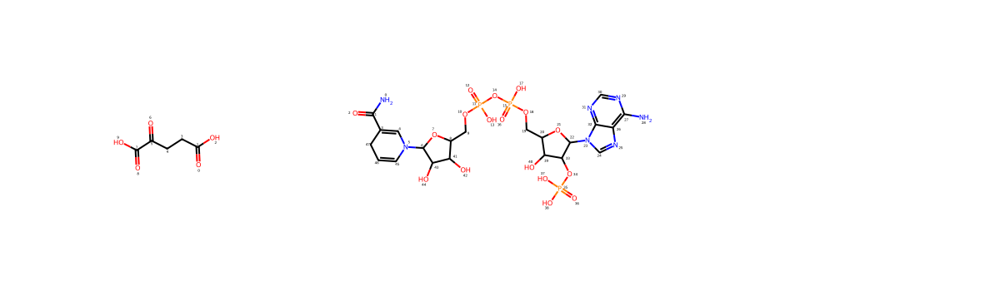

In [57]:
Draw.MolsToGridImage(pr_rcts, subImgSize=(400, 350))

In [58]:
pr_pdts_smis = pr_sma.split(">>")[1].split(".")
print(pr_pdts_smis)
print([Chem.CanonSmiles(elt) for elt in pr_pdts_smis])

['O=C(O)C(=O)CCC(O)O', 'NC(=O)c1ccc[n+](C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(OP(=O)(O)O)C3O)C(O)C2O)c1']
['O=C(O)C(=O)CCC(O)O', 'NC(=O)c1ccc[n+](C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(OP(=O)(O)O)C3O)C(O)C2O)c1']


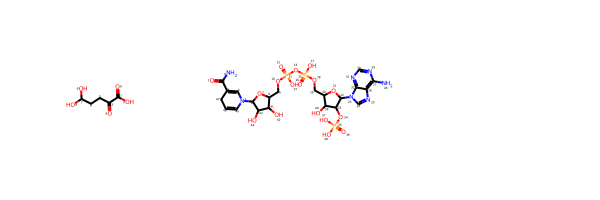

In [62]:
pr_rcts = ['O=C(O)C(=O)CCC(O)O', 'NC(=O)C1=CN(C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(OP(=O)(O)O)C3O)C(O)C2O)C=CC1']
Draw.MolsToGridImage([Chem.MolFromSmiles(smi) for smi in pr_rcts])

In [47]:
kr_rcts_smis = kr_sma.split(">>")[0].split(".")
print(kr_rcts_smis)
print([Chem.CanonSmiles(elt) for elt in kr_rcts_smis])

['C=CC(C)(SCC(NC(=O)CCC(N)C(=O)O)C(=O)NCC(=O)O)C(=O)O', 'NC(=O)C1=CN(C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(O)C3O)C(O)C2O)C=CC1', 'NC(=O)C1=CN(C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(O)C3O)C(O)C2O)C=CC1']
['C=CC(C)(SCC(NC(=O)CCC(N)C(=O)O)C(=O)NCC(=O)O)C(=O)O', 'NC(=O)C1=CN(C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(O)C3O)C(O)C2O)C=CC1', 'NC(=O)C1=CN(C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(O)C3O)C(O)C2O)C=CC1']


In [52]:
for i, row in min_rules.iterrows():
    for side in range(2):
        patts = get_patts_from_operator(row['SMARTS'], side)
        for patt in patts:
            mol_patt = Chem.MolFromSmarts(patt)
            print(mol_patt.GetAtomWithIdx(0).GetIsotope())

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


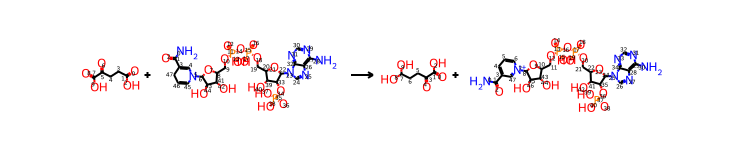

In [53]:
AllChem.ReactionFromSmarts('O=C(O)CCC(=O)C(=O)O.NC(=O)C1=CN(C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(OP(=O)(O)O)C3O)C(O)C2O)C=CC1>>O=C(O)C(=O)CCC(O)O.NC(=O)c1ccc[n+](C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(OP(=O)(O)O)C3O)C(O)C2O)c1', useSmiles=True)

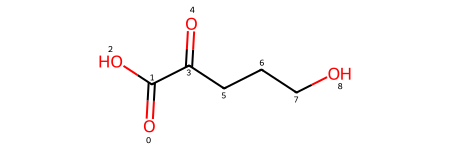

In [60]:
Chem.MolFromSmiles('O=C(O)C(=O)CCCO')

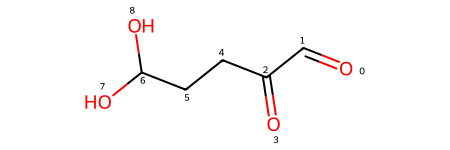

In [61]:
Chem.MolFromSmiles('O=CC(=O)CCC(O)O')

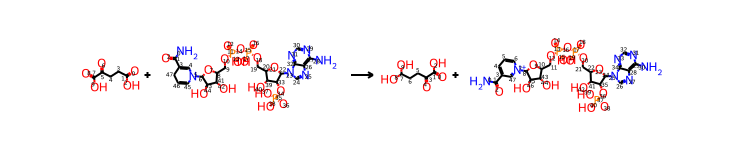

In [66]:
smarts = 'O=C(O)CCC(=O)C(=O)O.NC(=O)C1=CN(C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(OP(=O)(O)O)C3O)C(O)C2O)C=CC1>>O=C(O)C(=O)CCC(O)O.NC(=O)c1ccc[n+](C2OC(COP(=O)(O)OP(=O)(O)OCC3OC(n4cnc5c(N)ncnc54)C(OP(=O)(O)O)C3O)C(O)C2O)c1'
rmols, pmols = [[Chem.MolFromSmiles(elt) for elt in elt2.split('.')] for elt2 in smarts.split('>>')]
AllChem.ReactionFromSmarts(smarts, useSmiles=True)

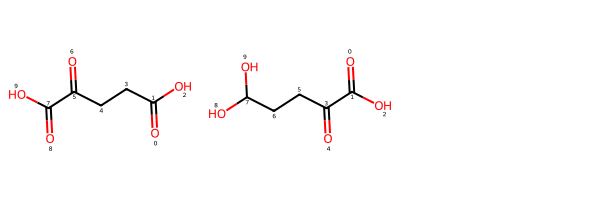

In [67]:
Draw.MolsToGridImage([rmols[0], pmols[0]])

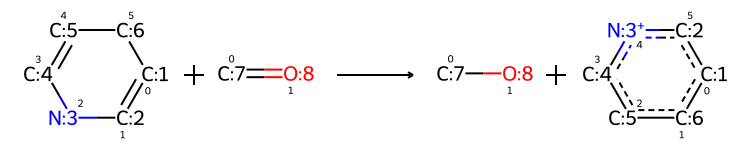

In [68]:
min_rule = '[#6:1]1=[#6:2]-[#7:3]-[#6:4]=[#6:5]-[#6:6]-1.[#6:7]=[#8:8]>>[#6:7]-[#8:8].[#6:1]1:[#6:6]:[#6:5]:[#6:4]:[#7+:3]:[#6:2]:1'
AllChem.ReactionFromSmarts(min_rule)

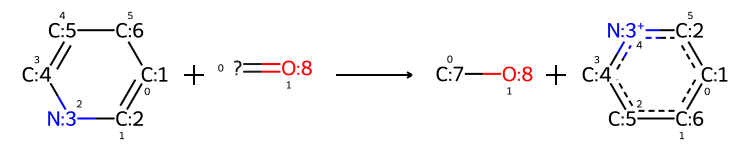

In [69]:
imt_rule = '[#6:1]1=[#6:2]-[#7:3]-[#6:4]=[#6:5]-[#6:6]-1.[#6;$([#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]);!$([#6&!R](-&!@[#6&!R])-&!@[#6&!R]-&!@[#6&!R](=&!@[#8&!R])-&!@[#16&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#7&!R]-&!@[#6&!R](=&!@[#8&!R])-&!@[#6&!R]-&!@[#6&!R]-&!@[#7&!R]-&!@[#6&!R](=&!@[#8&!R])-&!@[#6&!R](-&!@[#8&!R])-&!@[#6&!R](-&!@[#6&!R])(-&!@[#6&!R])-&!@[#6&!R]-&!@[#8&!R]-&!@[#15&!R](=&!@[#8&!R])(-&!@[#8&!R])-&!@[#8&!R]-&!@[#15&!R](=&!@[#8&!R])(-&!@[#8&!R])-&!@[#8&!R]-&!@[#6&!R]-&!@[#6&R]1-&@[#8&R]-&@[#6&R](-&@[#6&R](-&@[#6&R]-&@1-&!@[#8&!R]-&!@[#15&!R](=&!@[#8&!R])(-&!@[#8&!R])-&!@[#8&!R])-&!@[#8&!R])-&!@[#7&R]1:&@[#6&R]:&@[#7&R]:&@[#6&R]2:&@[#6&R]:&@1:&@[#7&R]:&@[#6&R]:&@[#7&R]:&@[#6&R]:&@2-&!@[#7&!R]);!$([#6&!R](-&!@[#6&!R](-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R](-&!@[#6&!R]-&!@[#6&!R](-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R])-&!@[#8&!R])-&!@[#8&!R])-&!@[#6&!R])-&!@[#6&!R]-&!@[#6&!R]);!$([#6&!R]-&!@[#6&!R](-&!@[#6&!R])-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R](-&!@[#6&!R])-&!@[#6&R]1-&@[#6&R]-&@[#6&R]-&@[#6&R]2-&@[#6&R]-&@1(-&@[#6&R]-&@[#6&R]-&@[#6&R]1-&@[#6&R]-&@2-&@[#6&R](-&!@[#8&!R])-&@[#6&R]-&@[#6&R]2-&@[#6&R]-&@1(-&@[#6&R]-&@[#6&R]-&@[#6&R](-&@[#6&R]-&@2)-&!@[#8&!R])-&!@[#6&!R])-&!@[#6&!R]);!$([#6&!R](-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R])-&!@[#6&!R]=&!@[#6&!R]-&!@[#6&R]1-&@[#6&R]-&@[#6&R]-&@[#6&R]-&@[#6&R]-&@1-&!@[#6&!R]-&!@[#6&!R]=&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R](=&!@[#8&!R])-&!@[#8&!R]);!$([#6&!R](-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R])-&!@[#6&!R](-&!@[#7&!R])-&!@[#6&!R]-&!@[#8&!R]);!$([#6&!R](-&!@[#6&!R](=&!@[#8&!R])-&!@[#8&!R])-&!@[#6&!R](-&!@[#8&!R])-&!@[#6&!R](-&!@[#8&!R])-&!@[#6&!R](-&!@[#8&!R])-&!@[#6&!R]-&!@[#8&!R]-&!@[#15&!R](=&!@[#8&!R])(-&!@[#8&!R])-&!@[#8&!R]);!$([#6&!R](-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R])-&!@[#6&!R]=&!@[#6&!R]-&!@[#6&R]1-&@[#6&R](-&!@[#8&!R])-&@[#6&R]-&@[#6&R]-&@[#6&R]-&@1-&!@[#6&!R]-&!@[#6&!R]);!$([#6&!R](-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R])-&!@[#6&!R]=&!@[#6&!R]-&!@[#6&R]1-&@[#6&R]-&@[#6&R]-&@[#6&R]-&@[#6&R]-&@1-&!@[#6&!R]-&!@[#6&!R]);!$([#6&!R](-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R])-&!@[#6&!R]=&!@[#6&!R]-&!@[#6&R]1-&@[#6&R]-&@[#6&R]-&@[#6&R]-&@[#6&R]-&@1);!$([#6&!R](-&!@[#6&!R](-&!@[#6&!R](-&!@[#6&!R](-&!@[#6&!R](=&!@[#8&!R])-&!@[#8&!R])=&!@[#8&!R])-&!@[#8&!R])-&!@[#8&!R])-&!@[#6&!R]-&!@[#8&!R]);!$([#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R](=&!@[#8&!R])-&!@[#8&!R]);!$([#6&!R](-&!@[#6&!R](-&!@[#6&!R]-&!@[#6&!R](-&!@[#6&!R](=&!@[#8&!R])-&!@[#8&!R])=&!@[#8&!R])-&!@[#8&!R])-&!@[#6&!R]-&!@[#8&!R]);!$([#6&!R](-&!@[#6&!R](-&!@[#6&!R](-&!@[#6&!R](-&!@[#6&!R]-&!@[#8&!R])-&!@[#8&!R])-&!@[#8&!R])-&!@[#8&!R])-&!@[#6&!R]);!$([#6&!R](-&!@[#6&!R](-&!@[#6&!R](-&!@[#6&!R]-&!@[#6&!R]-&!@[#8&!R])-&!@[#8&!R])-&!@[#8&!R])-&!@[#6&!R]-&!@[#8&!R]);!$([#6&!R](-&!@[#6&!R](=&!@[#8&!R])-&!@[#8&!R])-&!@[#6&!R]-&!@[#6&!R](-&!@[#8&!R])-&!@[#6&!R]-&!@[#6&!R]-&!@[#8&!R]);!$([#6&!R](-&!@[#6&!R]-&!@[#6&!R])-&!@[#6&R]1:&@[#6&R]:&@[#6&R]:&@[#6&R]:&@[#6&R]:&@[#6&R]:&@1);!$([#6&!R](-&!@[#6&!R](-&!@[#6&!R])-&!@[#6&!R](=&!@[#8&!R])-&!@[#8&!R])-&!@[#6&!R](=&!@[#8&!R])-&!@[#8&!R]);!$([#6&!R]-&!@[#6&!R]-&!@[#6&!R](-&!@[#6&!R])(-&!@[#8&!R])-&!@[#6&!R]-&!@[#6&!R](=&!@[#8&!R])-&!@[#8&!R]);!$([#6&!R]-&!@[#6&!R](-&!@[#6&!R](-&!@[#6&!R](-&!@[#6&!R]-&!@[#8&!R])-&!@[#8&!R])-&!@[#8&!R])-&!@[#8&!R]);!$([#6&!R](-&!@[#6&!R](=&!@[#8&!R])-&!@[#8&!R])-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#8&!R]);!$([#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R](=&!@[#8&!R])-&!@[#8&!R]);!$([#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]);!$([#6&!R](-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R])-&!@[#6&!R]);!$([#6&!R](-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R])-&!@[#6&!R](=&!@[#8&!R])-&!@[#8&!R]);!$([#6&!R](-&!@[#6&!R]-&!@[#6&!R]-&!@[#6&!R])-&!@[#6&!R]-&!@[#8&!R]);!$([#6&!R]-&!@[#6&!R]-&!@[#6&!R](-&!@[#6&!R])-&!@[#6&!R]):7]=[#8:8]>>[#6:7]-[#8:8].[#6:1]1:[#6:6]:[#6:5]:[#6:4]:[#7+:3]:[#6:2]:1'
AllChem.ReactionFromSmarts(imt_rule)

In [71]:
foo = (((1,2), (0.5, 0.8)), ((2,1), (0.6, 0.8)))
sorted(foo, key=lambda x : sum(x[1]) / len(x[1]), reverse=True)

[((2, 1), (0.6, 0.8)), ((1, 2), (0.5, 0.8))]

In [72]:

for k, v in krs.items():
    if 'rule0078_14' in v['imt_rules'] or 'rule0025_39' in v['imt_rules']:
        print(k, v)